# SIPN

This is a notebook attempting to generate outputs for [SIPN June forecast](https://www.arcus.org/sipn/sea-ice-outlook/2024/june/call).

Relates to the following issue (private repo), [icenet-governance](https://github.com/icenet-ai/icenet-governance/issues/1).

## Relevant abbreviations:

* SIC: Sea Ice Concentration
* SIA: Sea Ice Area
* SIE: Sea Ice Extent
* SIP: Sea Ice Probability
    * Fraction of ensemble members in an ensemble forecast with September SIC in excess of 15%.
* IAD: Ice Advance Date
    * For Aug and Sept only.
    * First day of the year in the freeze-up season (i.e., after the summer minimum) at which SIC first increases over:
        * IAD15: First day of year at which SIC increases over 15%.
        * IAD80: First day of year at which SIC increases over 80%.
* IFD: Ice-Free Date
    * IFD15: First day that SIC drops below 15%.
    * IFD80: First day that SIC drops below 90%.

## Sections:

_TBC_

## Training model

These results utilise the trained model corresponding to **ENVS.bas.exp23**, using **IceNet v0.2.4** (+bugfix), but predicted using **IceNet v0.2.9_dev**

## Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import logging
import os

from abc import abstractmethod
from functools import partial, partialmethod
from glob import glob
from pathlib import Path

import datetime as dt
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import xarray as xr

from ipywidgets import interact, IntSlider, SelectionSlider
from IPython.display import display, HTML, Image

In [3]:
from icenet.plotting.video import xarray_to_video as xvid
from icenet.data.sic.mask import Masks

[19-06-24 09:53:51 :WARNING ] - PyTorch not found - not required if not using PyTorch


## Inputs

This notebook assumes prediction was only completed for a singular date rather than specifying a range of dates for `icenet_predict`.

In [4]:
# Path to prediction files
north_prediction_path = "../pipeline/results/predict/fc.2024-05-31_north"
south_prediction_path = "../pipeline/results/predict/fc.2024-05-31_south"

# Start date for our forecast
date = [dt.date(*[2024, 5, 31])]

# Reference label used for output paths
output_reference = "BAS_icenet_june_2024"

# Download Masks

In [5]:
!icenet_data_masks north
!icenet_data_masks south

[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_01.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_02.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_03.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_04.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_05.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_06.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_07.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_08.npy, already exists
[19-06-24 09:53:52 :INFO    ] - Skipping ./data/masks/north/masks/active_grid_cell_mask_09.npy, already exists
[

# High-level code

Class interfacing with IceNet outputs.

In [6]:
class IceNetOutputPostProcess:
    def __init__(self, prediction_path, date: dt.date) -> None:
        self.prediction_path = prediction_path
        self.date = date

    @property
    def get_hemisphere(self):
        if self.north:
            return "north"
        elif self.south:
            return "south"
        else:
            raise Exception("Hemisphere not specified!")

    def get_mask(self):
        mask_gen = Masks(south=self.south, north=self.north)
        land_mask = mask_gen.get_land_mask()
        return mask_gen, land_mask

    def get_prediction_data_nb(self) -> tuple:
        """Read individual ensemble outputs of IceNet prediction.
        Based on IceNet library v0.2.7.
        
        Ref:
        https://github.com/icenet-ai/icenet/blob/cb1cb785808ba1138c0ed0f8f88208a144daa6ff/icenet/process/predict.py#L63-L89
        """
        glob_str = os.path.join(self.prediction_path, "*",
                                self.date.strftime("%Y_%m_%d.npy"))

        np_files = glob(glob_str)
        if not len(np_files):
            logging.warning("No files found")
            return None

        data = [np.load(f) for f in np_files]
        data = np.array(data)
        ens_members = data.shape[0]

        logging.debug("Data read from disk: {} from: {}".format(
            data.shape, np_files))

        return np.stack([data.mean(axis=0), data.std(axis=0)],
                        axis=-1).squeeze(), data, ens_members


    def create_ensemble_dataset(self, date_index=False):
        ds = xr.open_dataset(f"{self.prediction_path}.nc")

        # Dimensions for all data being inserted into xarray
        if date_index:
            data_dims_list = ["ensemble", "time", "yc", "xc", "forecast_date"]
        else:
            data_dims_list = ["ensemble", "time", "yc", "xc", "leadtime"]

        # Dict to store all ensemble results (for creating an xarray)
        sic_data = {}

        # Apply np.nan to land mask regions (emulating icenet output)
        mask_gen, land_mask = self.get_mask()
        land_mask_nan = land_mask.astype(float)
        land_mask_nan[land_mask] = np.nan
        land_mask_nan[~land_mask] = 1.0

        arr, data, ens_members = self.get_prediction_data_nb()
        dates = pd.to_datetime(ds.forecast_date[0])

        # Apply 0.0 to inactive cell regions
        for i, forecast_lead_date in enumerate(dates):
            # Get active cell mask for month of this forecast lead date
            grid_cell_mask = mask_gen.get_active_cell_mask(forecast_lead_date.month)
            # Applying to SIC mean read from numpy to directly compare against
            # `icenet_output` = 0
            # Apply to SIC mean
            arr[~grid_cell_mask, i, 0] = 0.0
            # Apply to SIC std dev
            arr[~grid_cell_mask, i, 1] = 0.0

            # Applying to Ensemble prediction outputs
            for ensemble in range(ens_members):
                data[ensemble, :, ~grid_cell_mask, i] = 0.0

        # for ensemble in range(ens_members):
        sic_data[f"sic"] = (data_dims_list, data*land_mask_nan[np.newaxis, np.newaxis, :, :, np.newaxis])

        sic_data.keys()

        # Create a dict with all variables to be stored in the xarray DataSet (incl. above ensemble results)
        data_vars=dict(
            Lambert_Azimuthal_Grid=ds.Lambert_Azimuthal_Grid.data,
            sic_mean=(data_dims_list[1:], ds.sic_mean.data),
            sic_stddev=(data_dims_list[1:], ds.sic_stddev.data),
            ensemble_members=(ens_members),
        )

        data_vars.update(sic_data)

        data_vars.keys()

        # Update longitude range to be 0 to 360 instead of -180 to 180
        # This would be for SIPN South submission, not SIPN Arcus.
        longitude = ds.lon.data.copy()
        ## longitude[longitude<0] += 360

        # print(ds.time.data)
        xarr = xr.Dataset(
            data_vars=data_vars,
            coords=dict(
                ensemble=list(range(ens_members)),
                time=[ds.time[0].data],
                leadtime=ds.leadtime.data,
                forecast_date=ds.forecast_date[0].data,
                xc=ds.xc.data,
                yc=ds.yc.data,
                lat=(("yc", "xc"), ds.lat.data),
                lon=(("yc", "xc"), longitude),
            )
        )
        if not date_index:
            self.xarr = xarr
        else:
            return xarr
        
        ds.close()

    def save_data(self, output_path, reference="BAS_icenet"):
        output_path = os.path.join(output_path,
                                "netcdf",
                                f"{reference}_{self.get_hemisphere}.nc"
                                )

        Path(os.path.dirname(output_path)).mkdir(parents=True, exist_ok=True)
        
        compression = dict(zlib=True, complevel=9)
        vars_encoding = {var: compression for var in self.xarr.data_vars}
        coords_encoding = {coord: compression for coord in self.xarr.coords}

        self.xarr.to_netcdf(output_path,
                        encoding=vars_encoding | coords_encoding
                    )

    def get_data_date_indexed(self):
        """Get forecast Xarray Dataset with forecast dates set as index
        instead of forecast index integers.
        """
        xarr = self.create_ensemble_dataset(date_index=True)
        return xarr

    def plot_ensemble_mean(self):
        """Plots the ensemble mean.
        """
        self.create_ensemble_dataset()
        mask_gen, land_mask = self.get_mask()

        forecast_date = self.xarr.time.values[0]
        
        fc = self.xarr.sic_mean.isel(time=0).drop_vars("time").rename(dict(leadtime="time"))
        fc['time'] = [pd.to_datetime(forecast_date) \
                    + dt.timedelta(days=int(e)) for e in fc.time.values]

        anim = xvid(fc, 15, figsize=4, mask=land_mask)
        display(HTML(anim.to_jshtml()))

Classes for computing Ice-Free Dates below 15% threshold.

In [7]:
class IceFreeDatesFromSICMean:
    """To compute/plot IFD from pre-computed SIC mean from ensemble outputs.
    """
    def compute_ice_free_dates_from_sic_mean(self, threshold=0.15, plot=True):
        """Ice Free Dates.

        The first day the SIC drops below 15% (IFD15).
        """
        xarr = self.xarr

        data = xarr.sic_mean.isel(time=0)
        mask_gen, land_mask = self.get_mask()
        land_mask_nan = land_mask.astype(float)
        land_mask_nan[land_mask] = np.nan
        land_mask_nan[~land_mask] = 1.0

        # Find the index of the first day where SIC hits the threshold
        matches = ( data <= threshold ).argmax(dim="leadtime")*land_mask_nan

        # ice_free_dates = np.full(matches.shape, np.nan)

        # for lead_idx in xarr.leadtime.values:
        #     idx = lead_idx - 1
        #     ice_free_dates[matches.values == idx] = xarr.leadtime[idx]
        
        xarr["ice_free_dates"] = (("yc", "xc"), matches.data)
        xarr["ice_free_dates"].attrs["description"] = "IFD15 calculated from sic_mean"

        if plot:
            # Identify first day of each month
            dates = xarr.forecast_date.values.astype("datetime64[D]")

            # Get array of unique months
            unique_months = np.unique(dates.astype("datetime64[M]"))

            # Include first day of the month
            first_of_months = unique_months + np.timedelta64(0, "D")

            img = xarr.ice_free_dates.plot.imshow()

            # Customise colourbar
            cbar = img.colorbar
            cbar.set_label("")
            tick_positions = [(date - dates[0]).astype(int) for date in first_of_months]
            cbar.set_ticks(tick_positions)
            cbar.set_ticklabels([date.astype(dt.datetime).strftime("%b %-d") for date in first_of_months])

            # Hide x and y-axis labels
            img.axes.xaxis.set_visible(False)
            img.axes.yaxis.set_visible(False)

            plt.title("Ice-Free Dates (IFD15)")

        return xarr

In [8]:
class IceFreeDatesFromSICEnsemble:
    """To compute/plot IFD from individual ensemble member outputs
    """
    def __init__(self) -> None:
        pass

    @staticmethod
    def plot_ice_free_dates_from_sic_ensemble(ifd_data, dates, index):
        """Interactive plot of Ice-Free Dates 15% for all ensemble members.
        """
        # Identify first day of each month
        dates = dates.astype("datetime64[D]")

        # Get array of unique months
        unique_months = np.unique(dates.astype("datetime64[M]"))

        # Include first day of the month
        first_of_months = unique_months + np.timedelta64(0, "D")

        img = ifd_data[index].plot.imshow()

        # Customise colourbar
        cbar = img.colorbar
        cbar.set_label("")
        tick_positions = [(date - dates[0]).astype(int) for date in first_of_months]
        cbar.set_ticks(tick_positions)
        cbar.set_ticklabels([date.astype(dt.datetime).strftime("%b %-d") for date in first_of_months])

        # Hide x and y-axis labels
        img.axes.xaxis.set_visible(False)
        img.axes.yaxis.set_visible(False)

        title = f"Ice-Free Dates (IFD15) | Ensemble {index}"

        plt.title(title)
        plt.show()

    @staticmethod
    def plot_ice_free_dates_from_ensemble_mean_stddev(ifd_mean, ifd_stddev, dates):
        """Ice-Free Dates 15% for an ensemble mean and corresponding standard deviation.
        """
        # Identify first day of each month
        dates = dates.astype("datetime64[D]")

        # Get array of unique months
        unique_months = np.unique(dates.astype("datetime64[M]"))

        # Include first day of the month
        first_of_months = unique_months + np.timedelta64(0, "D")

        img = ifd_mean.plot.imshow()

        # Customise colourbar
        cbar = img.colorbar
        cbar.set_label("")
        tick_positions = [(date - dates[0]).astype(int) for date in first_of_months]
        cbar.set_ticks(tick_positions)
        cbar.set_ticklabels([date.astype(dt.datetime).strftime("%b %-d") for date in first_of_months])

        plt.title(f"Ice-Free Dates (IFD15) Mean")

        # Hide x and y-axis labels
        img.axes.xaxis.set_visible(False)
        img.axes.yaxis.set_visible(False)

        plt.show()

        img = ifd_stddev.plot.imshow()

        # Customise colourbar
        cbar = img.colorbar
        cbar.set_label("Days")

        img.axes.xaxis.set_visible(False)
        img.axes.yaxis.set_visible(False)

        plt.title(f"Ice-Free Dates (IFD15) Standard Deviation")

        plt.show()

    def compute_ice_free_dates_for_single_sic(self, sic, dates=None, threshold=0.15, plot=False):
        """Ice Free Dates for a single ensemble member or sic_mean.

        The first day the SIC drops below 15% (IFD15).
        """
        land_mask = Masks(south=False, north=True).get_land_mask()
        land_mask_nan = land_mask.astype(float)
        land_mask_nan[land_mask] = np.nan
        land_mask_nan[~land_mask] = 1.0

        # Find the index of the first day where SIC hits the threshold
        ice_free_dates = ( sic <= threshold ).argmax(dim="leadtime")*land_mask_nan

        return ice_free_dates

    def compute_ice_free_dates_from_sic_ensemble(self, threshold=0.15, plot=True):
        """Ice Free Dates.

        The first day the SIC drops below 15% (IFD15).
        """
        xarr = self.xarr
        ensembles = list(range(xarr.ensemble_members.data))

        kwargs = {"threshold": threshold, "plot": plot, "dates": xarr.forecast_date.values}
        ice_free_dates_ensemble = np.asarray([xarr.sic.isel(time=0, ensemble=ensemble).map_blocks(self.compute_ice_free_dates_for_single_sic, kwargs=kwargs).values for ensemble in ensembles])
        ice_free_dates_mean = ice_free_dates_ensemble.mean(axis=0)
        ice_free_dates_stddev = ice_free_dates_ensemble.std(axis=0)

        xarr["ice_free_dates"] = (("ensemble", "yc", "xc"), ice_free_dates_ensemble.data)
        xarr["ice_free_dates"].attrs["description"] = "IFD15 per ensemble"
        xarr["ice_free_dates_mean"] = (("yc", "xc"), ice_free_dates_mean.data)
        xarr["ice_free_dates"].attrs["description"] = "Mean from ensemble IFD15 calculation"
        xarr["ice_free_dates_stddev"] = (("yc", "xc"), ice_free_dates_stddev.data)
        xarr["ice_free_dates"].attrs["description"] = "Standard Deviation from ensemble IFD15 calculation"

        if plot:
            # Plot IFD15 ensemble results
            partial_plot_ice_free_dates = partial(self.plot_ice_free_dates_from_sic_ensemble, xarr["ice_free_dates"], xarr.forecast_date.values)

            def wrapped_plot_func(index):
                """Wrap partial plot func so that it has a __name__ for ipywidgets to work
                with partial func call.
                """
                partial_plot_ice_free_dates(index)

            interact(wrapped_plot_func, index=SelectionSlider(options=ensembles, value=ensembles[0], description="Ensemble"))

            # Plot IFD15 mean and standard deviation results
            self.plot_ice_free_dates_from_ensemble_mean_stddev(xarr["ice_free_dates_mean"], xarr["ice_free_dates_stddev"], xarr.forecast_date.values)

        return xarr


In [9]:
class SIPNOutputs(IceNetOutputPostProcess, IceFreeDatesFromSICMean, IceFreeDatesFromSICEnsemble):
    """SIPN ARCUS Sea Ice Outlook Submission for IceNet (with daily averaging 
    up to 93 day leadtime)
    
    Refer here: https://www.arcus.org/sipn/sea-ice-outlook/2023/june
    """
    def __init__(self, hemisphere: str, prediction_path: str, date: dt.date) -> None:
        """
        Args:
            prediction_path: Path to the numpy prediction outputs
        """
        self.north = False
        self.south = False
        self.hemisphere = hemisphere
        if hemisphere.casefold() == "north":
            self.north = True
        elif hemisphere.casefold() == "south":
            self.south = True
        else:
            raise Exception("Incorrect hemisphere specified, should be `north` or `south`")

        super().__init__(prediction_path, date)
        self.create_ensemble_dataset()


    def check_forecast_period(self):
        """Used to check that the forecast period is within June-November.
        """
        raise NotImplementedError


    def compute_sea_ice_extent(self, sea_ice_concentration, ensemble_axis=None, grid_cell_area=25*25,
                                threshold=0.15, plot=False):
        """Compute Sea Ice Extent for an image for a given day.

        Computes the total extent (SIC>15%) for one day.
        """
        sic = sea_ice_concentration
        # print(sic.data.shape)

        # Mask values less than the threshold
        sic = sic.where(sic>threshold)

        if plot:
            xr.plot.imshow(sic.squeeze())

        # Multiply by grid-cell area
        sic *= grid_cell_area

        if ensemble_axis == None or len(sic.shape) < 4:
            valid_axes = tuple(i for i in range(len(sic.shape)))
        else:
            valid_axes = tuple(i for i in range(len(sic.shape)) if i != ensemble_axis)

        # Divide by 10^6 to get:
        # (units in 10^6 km^2)
        # Sum across all axes except ensemble
        sea_ice_extent = sic.sum(axis=valid_axes) / 1E6

        return sea_ice_extent

    def compute_daily_sea_ice_extent(self, grid_cell_area=25*25, threshold=0.15, plot=False):
        """Daily Sea Ice Extent.

        Computes the total extent (SIC>15%) for each day.
        """
        kwargs = {"ensemble_axis": 0, "grid_cell_area": grid_cell_area, "threshold": threshold, "plot": plot}
        sea_ice_extent_daily_ensemble = np.asarray([self.xarr.sic.isel(leadtime=day-1).map_blocks(self.compute_sea_ice_extent, kwargs=kwargs).values for day in self.xarr.leadtime]);
        sea_ice_extent_daily_mean = sea_ice_extent_daily_ensemble.mean(axis=1)
        sea_ice_extent_daily_stddev = sea_ice_extent_daily_ensemble.std(axis=1)
        forecast_dates = pd.to_datetime(self.xarr.forecast_date)
        sea_ice_extent_daily_ds = xr.Dataset(
            data_vars=dict(
                sea_ice_extent_daily = (["day", "ensemble"], sea_ice_extent_daily_ensemble),
                sea_ice_extent_daily_mean = (["day"], sea_ice_extent_daily_mean),
                sea_ice_extent_daily_stddev = (["day"], sea_ice_extent_daily_stddev),
            ),
            coords=dict(
                day=forecast_dates,
                ensemble=list(range(sea_ice_extent_daily_ensemble.shape[1]))
            )
        )
        return sea_ice_extent_daily_ds

    def compute_monthly_sea_ice_extent(self, grid_cell_area=25*25, threshold=0.15, plot=False):
        """Monthly Sea Ice Extent from daily.

        Computes the total extent (SIC>15%) for each day, then, averages the extent
        from each of the days of the month into a monthly average extent.

        To be consistent with NSIDC Sea Ice Index extent.
        """
        sea_ice_extent_daily_ds = self.compute_daily_sea_ice_extent(grid_cell_area=grid_cell_area, threshold=threshold, plot=plot)

        sea_ice_extent_monthly_ds = sea_ice_extent_daily_ds.sea_ice_extent_daily_mean.groupby(sea_ice_extent_daily_ds.day.dt.month).mean().rename("sea_ice_extent_monthly_mean")

        self.xarr["sea_ice_extent_monthly_mean"] = sea_ice_extent_monthly_ds

        return sea_ice_extent_monthly_ds

    def get_data(self):
        return self.xarr


# North

Load up forecast files (ensemble `*.npy` and ensemble averaged `{forecast}.nc`) from IceNet prediction.

In [10]:
north_prediction = SIPNOutputs(hemisphere="north", prediction_path=north_prediction_path, date=date[0])

Visualising forecast for sanity.

In [11]:
north_prediction.plot_ensemble_mean()

### 1. Sea Ice Extent

Compute daily sea ice extent over 93 day period from forecast initialisation.

In [12]:
north_prediction.compute_daily_sea_ice_extent().sea_ice_extent_daily_mean

<xarray.DataArray 'sea_ice_extent_daily_mean' (day: 93)> Size: 744B
array([10.26002129, 10.21190766, 10.14641666, 10.08253836, 10.01404689,
        9.95448114,  9.88618232,  9.83015718,  9.74451339,  9.67463886,
        9.59228137,  9.51248657,  9.43881514,  9.35522557,  9.25212776,
        9.15540362,  9.07419167,  8.96253932,  8.84646943,  8.75014127,
        8.63401615,  8.53218201,  8.40897925,  8.29338652,  8.15855618,
        8.03321575,  7.90776617,  7.7913401 ,  7.66217343,  7.53592823,
        7.41125039,  7.26626115,  7.17083233,  7.0776526 ,  6.99582671,
        6.88821182,  6.82274188,  6.72620479,  6.65253718,  6.58678496,
        6.51732343,  6.44744826,  6.39040688,  6.30811294,  6.24228445,
        6.15892079,  6.09060671,  6.00597512,  5.94276897,  5.87973611,
        5.80457647,  5.73103988,  5.65379269,  5.60287822,  5.53408472,
        5.46983549,  5.40583578,  5.33733905,  5.28024055,  5.22110491,
        5.15670863,  5.02773977,  4.96098183,  4.89860786,  4.82771417,
        4.76722704,  4.69703789,  4.64033726,  4.57763457,  4.51029636,
        4.45151379,  4.38805892,  4.32317586,  4.25577806,  4.19413349,
        4.13559212,  4.08237457,  4.0243323 ,  3.96470742,  3.92711501,
        3.88099748,  3.83318172,  3.79681777,  3.74124482,  3.6980329 ,
        3.66147798,  3.63016715,  3.58764606,  3.56400643,  3.54188248,
        3.52656002,  3.51048226,  3.47801352])
Coordinates:
  * day      (day) datetime64[ns] 744B 2024-06-01 2024-06-02 ... 2024-09-01

Compute monthly sea ice extent over the forecast period.

In [13]:
north_prediction.compute_monthly_sea_ice_extent()

<xarray.DataArray 'sea_ice_extent_monthly_mean' (month: 4)> Size: 32B
array([9.09007098, 6.1864298 , 4.1492534 , 3.47801352])
Coordinates:
  * month    (month) int64 32B 6 7 8 9

View the Xarray Dataset folder including monthly sea ice extent as required for SIPN. The added variable is called `sea_ice_extent_monthly_mean`.

In [14]:
north_prediction.get_data()

<xarray.Dataset> Size: 2GB
Dimensions:                      (time: 1, yc: 432, xc: 432, leadtime: 93,
                                  ensemble: 10, forecast_date: 93, month: 4)
Coordinates:
  * ensemble                     (ensemble) int64 80B 0 1 2 3 4 5 6 7 8 9
  * time                         (time) datetime64[ns] 8B 2024-05-31
  * leadtime                     (leadtime) int64 744B 1 2 3 4 5 ... 90 91 92 93
  * forecast_date                (forecast_date) datetime64[ns] 744B 2024-06-...
  * xc                           (xc) float64 3kB -5.388e+03 ... 5.388e+03
  * yc                           (yc) float64 3kB 5.388e+03 ... -5.388e+03
    lat                          (yc, xc) float32 746kB 16.62 16.82 ... 16.62
    lon                          (yc, xc) float32 746kB -135.0 -135.1 ... 45.0
  * month                        (month) int64 32B 6 7 8 9
Data variables:
    Lambert_Azimuthal_Grid       int32 4B -2147483647
    sic_mean                     (time, yc, xc, leadtime) float32 69MB 0.0 .....
    sic_stddev                   (time, yc, xc, leadtime) float32 69MB 0.0 .....
    ensemble_members             int64 8B 10
    sic                          (ensemble, time, yc, xc, leadtime) float64 1GB ...
    sea_ice_extent_monthly_mean  (month) float64 32B 9.09 6.186 4.149 3.478

### 2. Ice-Free Dates

Plot of the first day that SIC drops below 15% ('IFD15').

Calculated by using the mean Sea Ice Concentration.

#### Computing from `sic_mean`

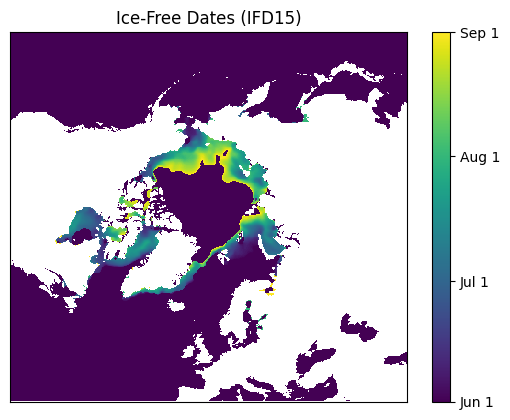

In [15]:
north_prediction.compute_ice_free_dates_from_sic_mean(plot=True);

Please pick only one of the two below options, else the latter call will overwrite the former.

**Option 1:** Calculating Ice-Free Dates 15% from `sic_mean` directly.

<xarray.Dataset> Size: 2GB
Dimensions:                      (time: 1, yc: 432, xc: 432, leadtime: 93,
                                  ensemble: 10, forecast_date: 93, month: 4)
Coordinates:
  * ensemble                     (ensemble) int64 80B 0 1 2 3 4 5 6 7 8 9
  * time                         (time) datetime64[ns] 8B 2024-05-31
  * leadtime                     (leadtime) int64 744B 1 2 3 4 5 ... 90 91 92 93
  * forecast_date                (forecast_date) datetime64[ns] 744B 2024-06-...
  * xc                           (xc) float64 3kB -5.388e+03 ... 5.388e+03
  * yc                           (yc) float64 3kB 5.388e+03 ... -5.388e+03
    lat                          (yc, xc) float32 746kB 16.62 16.82 ... 16.62
    lon                          (yc, xc) float32 746kB -135.0 -135.1 ... 45.0
  * month                        (month) int64 32B 6 7 8 9
Data variables:
    Lambert_Azimuthal_Grid       int32 4B -2147483647
    sic_mean                     (time, yc, xc, leadtime) float32 69MB 0.0 .....
    sic_stddev                   (time, yc, xc, leadtime) float32 69MB 0.0 .....
    ensemble_members             int64 8B 10
    sic                          (ensemble, time, yc, xc, leadtime) float64 1GB ...
    sea_ice_extent_monthly_mean  (month) float64 32B 9.09 6.186 4.149 3.478
    ice_free_dates               (yc, xc) float64 1MB 0.0 0.0 0.0 ... nan nan

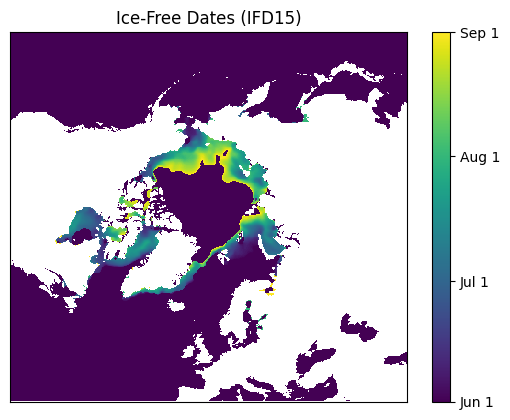

In [16]:
north_prediction.compute_ice_free_dates_from_sic_mean(plot=True)

**Option 2:** Calculating Ice-Free Dates 15% by independently calculating it for each SIC ensemble, then finding its mean.

interactive(children=(SelectionSlider(description='Ensemble', options=(0, 1, 2, 3, 4, 5, 6, 7, 8, 9), value=0)…

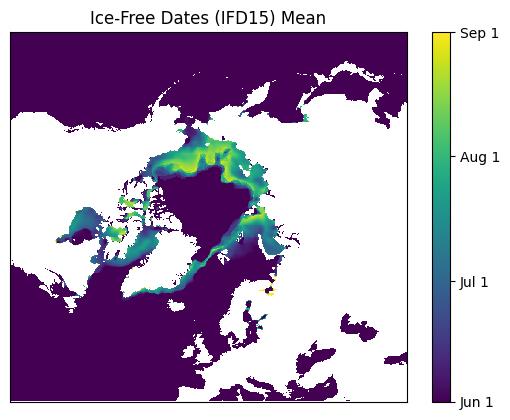

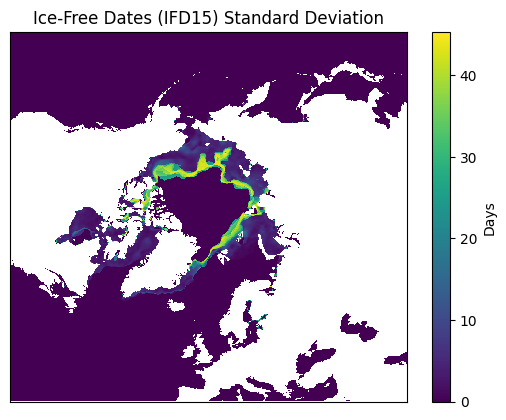

<xarray.Dataset> Size: 2GB
Dimensions:                      (time: 1, yc: 432, xc: 432, leadtime: 93,
                                  ensemble: 10, forecast_date: 93, month: 4)
Coordinates:
  * ensemble                     (ensemble) int64 80B 0 1 2 3 4 5 6 7 8 9
  * time                         (time) datetime64[ns] 8B 2024-05-31
  * leadtime                     (leadtime) int64 744B 1 2 3 4 5 ... 90 91 92 93
  * forecast_date                (forecast_date) datetime64[ns] 744B 2024-06-...
  * xc                           (xc) float64 3kB -5.388e+03 ... 5.388e+03
  * yc                           (yc) float64 3kB 5.388e+03 ... -5.388e+03
    lat                          (yc, xc) float32 746kB 16.62 16.82 ... 16.62
    lon                          (yc, xc) float32 746kB -135.0 -135.1 ... 45.0
  * month                        (month) int64 32B 6 7 8 9
Data variables:
    Lambert_Azimuthal_Grid       int32 4B -2147483647
    sic_mean                     (time, yc, xc, leadtime) float32 69MB 0.0 .....
    sic_stddev                   (time, yc, xc, leadtime) float32 69MB 0.0 .....
    ensemble_members             int64 8B 10
    sic                          (ensemble, time, yc, xc, leadtime) float64 1GB ...
    sea_ice_extent_monthly_mean  (month) float64 32B 9.09 6.186 4.149 3.478
    ice_free_dates               (ensemble, yc, xc) float64 15MB 0.0 0.0 ... nan
    ice_free_dates_mean          (yc, xc) float64 1MB 0.0 0.0 0.0 ... nan nan
    ice_free_dates_stddev        (yc, xc) float64 1MB 0.0 0.0 0.0 ... nan nan

In [17]:
north_prediction.compute_ice_free_dates_from_sic_ensemble(plot=True)

Save Xarray Dataset with metrics to netCDF file.

In [18]:
north_prediction.save_data(output_path="outputs", reference=output_reference)

___

# South

The outlooks requested for the Southern hemisphere are limited to only monthly Sea Ice Extent and its uncertainty rather than the full suite of outlooks as per the Northern hemisphere.

Since the code is hemisphere agnostic, explanations for each command are the same as above.

In [19]:
south_prediction = SIPNOutputs(hemisphere="south", prediction_path=south_prediction_path, date=date[0])

Plot forecast for sanity check.

In [20]:
south_prediction.plot_ensemble_mean()

In [21]:
sie_monthly_ds = south_prediction.compute_monthly_sea_ice_extent()
sie_monthly_ds

<xarray.DataArray 'sea_ice_extent_monthly_mean' (month: 4)> Size: 32B
array([10.90934519, 13.33338067, 15.23463635, 15.72434727])
Coordinates:
  * month    (month) int64 32B 6 7 8 9

In [22]:
south_prediction.save_data(output_path="outputs", reference=output_reference)